In [2]:
# from google.colab import files
# files.upload()

In [3]:
# from google.colab import drive
# drive.mount('/content/drive')

In [5]:
# !mkdir ~/.kaggle
# !cp kaggle.json ~/.kaggle/
# !chmod 600 ~/.kaggle/kaggle.json

In [2]:
!kaggle datasets list

ref                                                                title                                            size  lastUpdated          downloadCount  voteCount  usabilityRating  
-----------------------------------------------------------------  ----------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
themrityunjaypathak/covid-cases-and-deaths-worldwide               Covid Cases and Deaths WorldWide                  8KB  2023-02-01 12:22:51           7941        254  1.0              
amaanansari09/top-100-songs                                        Top 100 songs                                     6KB  2023-02-16 18:55:35           1786         69  1.0              
datascientistanna/customers-dataset                                Shop Customer Data                               23KB  2023-02-07 18:42:21           6346        149  1.0              
thedevastator/airbnb-prices-in-european-cities                   

In [3]:
# Download the dataset
!kaggle competitions download -c dogs-vs-cats-redux-kernels-edition


  0%|          | 0.00/814M [00:00<?, ?B/s]
  0%|          | 1.00M/814M [00:00<03:57, 3.59MB/s]
  0%|          | 2.00M/814M [00:00<02:32, 5.60MB/s]
  0%|          | 4.00M/814M [00:00<01:42, 8.28MB/s]
  1%|          | 6.00M/814M [00:00<01:28, 9.57MB/s]
  1%|          | 8.00M/814M [00:00<01:22, 10.3MB/s]
  1%|          | 10.0M/814M [00:01<01:17, 10.8MB/s]
  1%|▏         | 12.0M/814M [00:01<01:15, 11.1MB/s]
  2%|▏         | 14.0M/814M [00:01<01:23, 10.0MB/s]
  2%|▏         | 16.0M/814M [00:01<01:19, 10.5MB/s]
  2%|▏         | 18.0M/814M [00:01<01:16, 10.9MB/s]
  2%|▏         | 20.0M/814M [00:02<01:15, 11.0MB/s]
  3%|▎         | 22.0M/814M [00:02<01:14, 11.2MB/s]
  3%|▎         | 24.0M/814M [00:02<01:12, 11.4MB/s]
  3%|▎         | 26.0M/814M [00:02<01:12, 11.4MB/s]
  3%|▎         | 28.0M/814M [00:02<01:11, 11.5MB/s]
  4%|▎         | 30.0M/814M [00:02<01:11, 11.6MB/s]
  4%|▍         | 32.0M/814M [00:03<01:10, 11.6MB/s]
  4%|▍         | 34.0M/814M [00:03<01:10, 11.6MB/s]
  4%|▍         | 36.

In [4]:
# Unzip the dataset
!tar -xf dogs-vs-cats-redux-kernels-edition.zip
!tar -xf test.zip
!tar -xf train.zip

In [1]:
# Import modules
import os
from PIL import Image
import random
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.io import read_image, ImageReadMode
import random
import numpy as np

c:\Users\Melgani\anaconda3\envs\newnlpt\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


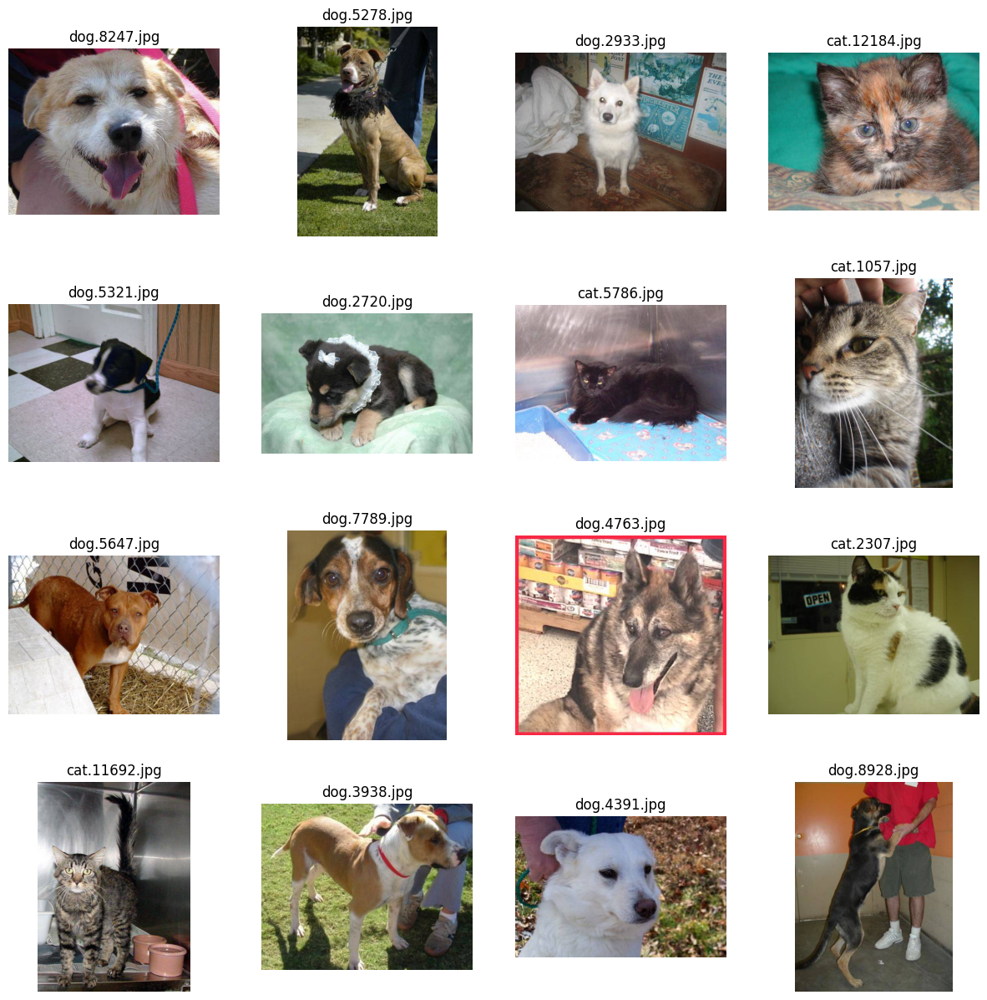

In [2]:
# Explore the data 
files_train = os.listdir("train")
random.shuffle(files_train)
fig = plt.figure(figsize=(15,15))
num_images = 16
for num, fn in enumerate(files_train[:num_images]):
  path = os.path.join("train",fn)
  img = Image.open(path)
  plt.subplot(num_images//4,4,num+1)
  plt.title(fn)
  plt.axis('off')
  plt.imshow(img)

In [3]:
# Create funtions to seet random seeds for reproducibility
def _init_seed(seed):
  os.environ['PYTHONHASHSEED'] = str(seed)
  torch.manual_seed(seed)
  torch.cuda.manual_seed(seed)
  torch.cuda.manual_seed_all(seed)  # if you are using multi-GPU.
  np.random.seed(seed)  # Numpy module.
  random.seed(seed)  # Python random module.
  torch.backends.cudnn.benchmark = False
  torch.backends.cudnn.deterministic = True

def _init_fn(worker_id):
    np.random.seed(0 + worker_id)

In [3]:
class SimpleNet(nn.Module):
    def __init__(self):
        super(SimpleNet, self).__init__() 
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=32, kernel_size=3, stride=1, padding=1, bias=False) # Important bias = False
        self.norm1 = nn.BatchNorm2d(num_features=32)
        self.conv2 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1, bias=False) # Important bias = False
        self.norm2 = nn.BatchNorm2d(num_features=64)
        self.conv3 = nn.Conv2d(in_channels=64, out_channels=32, kernel_size=3, stride=1, padding=1, bias=False) # Important bias = False
        self.norm3 = nn.BatchNorm2d(num_features=32)
        self.conv4 = nn.Conv2d(in_channels=32, out_channels=16, kernel_size=3, stride=1, padding=1, bias=False) # Important bias = False
        self.norm4 = nn.BatchNorm2d(num_features=16)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        self.final_pool = nn.AdaptiveAvgPool2d(output_size=(16,16))
        self.fc1 = nn.Linear(in_features=16**3, out_features=128, bias=False) # Important bias = False
        self.norm5 = nn.BatchNorm1d(num_features=128)
        self.fc2 = nn.Linear(in_features=128, out_features=1)
        self.dropout = nn.Dropout(p=0.3)
        self.tanh = nn.Tanh()
        
        self.sigmoid = nn.Sigmoid()

    def forward(self, imgs):
        out_first_conv = self.tanh(self.pool(self.conv1(imgs)))
        out_first_conv = self.dropout(self.norm1(out_first_conv))

        out_second_conv = self.tanh(self.pool(self.conv2(out_first_conv)))
        out_second_conv = self.dropout(self.norm2(out_second_conv))

        out_third_conv = self.tanh(self.conv3(out_second_conv))
        out_third_conv = self.dropout(self.norm3(out_third_conv))

        out_fourth_conv = self.tanh(self.pool(self.conv4(out_third_conv)))
        out_fourth_conv = self.dropout(self.norm4(self.final_pool(out_fourth_conv)))
        
        out_first_fc = self.tanh(self.fc1(out_fourth_conv.view(out_fourth_conv.shape[0],-1)))
        out_first_fc = self.dropout(self.norm5(out_first_fc))
        
        out_second_fc = self.sigmoid(self.fc2(out_first_fc))
        return out_second_fc

In [4]:
# Build datasets, dataloader
import torchvision.transforms as transf

transforms_train = transf.Compose([transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])
transforms_test_val = transf.Compose([transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))])

In [5]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

_init_seed(0)

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

##############################################################################

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = SimpleNet()
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))

# Hyperparameters 
learning_rate = 5e-3
epochs = 20 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

Tot model parameters: 567297
Epoch: 0


100%|██████████| 79/79 [00:15<00:00,  5.20it/s]



Training loss epoch  0 : 0.638370896350931
Training accuracy epoch  0 : 0.6299715909090909
Validation loss epoch  0 : 0.6860380014286765
Validation accuracy epoch  0 : 0.6147151898734177
Epoch: 1


100%|██████████| 79/79 [00:12<00:00,  6.10it/s]



Training loss epoch  1 : 0.5839385869912803
Training accuracy epoch  1 : 0.6854580965909091
Validation loss epoch  1 : 0.6007067214084577
Validation accuracy epoch  1 : 0.6574367088607594
Epoch: 2


100%|██████████| 79/79 [00:12<00:00,  6.47it/s]



Training loss epoch  2 : 0.5550560430962254
Training accuracy epoch  2 : 0.7094282670454546
Validation loss epoch  2 : 0.7336667515809023
Validation accuracy epoch  2 : 0.6123417721518988
Epoch: 3


100%|██████████| 79/79 [00:14<00:00,  5.38it/s]



Training loss epoch  3 : 0.5378775973169302
Training accuracy epoch  3 : 0.7261186079545454
Validation loss epoch  3 : 1.0296938590988327
Validation accuracy epoch  3 : 0.5735759493670886
Epoch: 4


100%|██████████| 79/79 [00:15<00:00,  5.07it/s]



Training loss epoch  4 : 0.5468605004505
Training accuracy epoch  4 : 0.7185724431818182
Validation loss epoch  4 : 0.9069409015812452
Validation accuracy epoch  4 : 0.5450949367088608
Epoch: 5


100%|██████████| 79/79 [00:14<00:00,  5.28it/s]



Training loss epoch  5 : 0.5240396669092164
Training accuracy epoch  5 : 0.7370383522727273
Validation loss epoch  5 : 0.8165223839916761
Validation accuracy epoch  5 : 0.5514240506329114
Epoch: 6


100%|██████████| 79/79 [00:17<00:00,  4.63it/s]



Training loss epoch  6 : 0.510650736300952
Training accuracy epoch  6 : 0.7459161931818182
Validation loss epoch  6 : 0.9704214055326921
Validation accuracy epoch  6 : 0.5419303797468354
Epoch: 7


100%|██████████| 79/79 [00:17<00:00,  4.52it/s]



Training loss epoch  7 : 0.5665230125781487
Training accuracy epoch  7 : 0.7029474431818182
Validation loss epoch  7 : 1.0075985697345644
Validation accuracy epoch  7 : 0.571993670886076
Epoch: 8


100%|██████████| 79/79 [00:15<00:00,  5.15it/s]



Training loss epoch  8 : 0.5294911468570883
Training accuracy epoch  8 : 0.7318004261363636
Validation loss epoch  8 : 0.6629294439961638
Validation accuracy epoch  8 : 0.6416139240506329
Epoch: 9


100%|██████████| 79/79 [00:15<00:00,  5.20it/s]



Training loss epoch  9 : 0.5067034679549661
Training accuracy epoch  9 : 0.7484019886363636
Validation loss epoch  9 : 0.6406182069567186
Validation accuracy epoch  9 : 0.6621835443037974
Epoch: 10


100%|██████████| 79/79 [00:15<00:00,  4.96it/s]



Training loss epoch  10 : 0.49573332331651315
Training accuracy epoch  10 : 0.7563032670454546
Validation loss epoch  10 : 0.7598749338826046
Validation accuracy epoch  10 : 0.615506329113924
Epoch: 11


100%|██████████| 79/79 [00:16<00:00,  4.78it/s]



Training loss epoch  11 : 0.48292606484822254
Training accuracy epoch  11 : 0.7683771306818182
Validation loss epoch  11 : 0.94860741156566
Validation accuracy epoch  11 : 0.5680379746835443
Epoch: 12


100%|██████████| 79/79 [00:15<00:00,  5.12it/s]



Training loss epoch  12 : 0.47894019817679445
Training accuracy epoch  12 : 0.7673117897727273
Validation loss epoch  12 : 0.7889738362046737
Validation accuracy epoch  12 : 0.5799050632911392
Epoch: 13


100%|██████████| 79/79 [00:17<00:00,  4.53it/s]



Training loss epoch  13 : 0.4745727454693141
Training accuracy epoch  13 : 0.7683771306818182
Validation loss epoch  13 : 0.9056908171388167
Validation accuracy epoch  13 : 0.5363924050632911
Epoch: 14


100%|██████████| 79/79 [00:16<00:00,  4.92it/s]



Training loss epoch  14 : 0.470040389908139
Training accuracy epoch  14 : 0.7686434659090909
Validation loss epoch  14 : 0.9757594586927679
Validation accuracy epoch  14 : 0.5688291139240507
Epoch: 15


100%|██████████| 79/79 [00:16<00:00,  4.78it/s]



Training loss epoch  15 : 0.466209809592163
Training accuracy epoch  15 : 0.7747691761363636
Validation loss epoch  15 : 0.9165595019165473
Validation accuracy epoch  15 : 0.5450949367088608
Epoch: 16


100%|██████████| 79/79 [00:16<00:00,  4.76it/s]



Training loss epoch  16 : 0.4574946647890928
Training accuracy epoch  16 : 0.7806285511363636
Validation loss epoch  16 : 0.9173297572739517
Validation accuracy epoch  16 : 0.5458860759493671
Epoch: 17


100%|██████████| 79/79 [00:14<00:00,  5.36it/s]



Training loss epoch  17 : 0.4541625833477486
Training accuracy epoch  17 : 0.7872869318181818
Validation loss epoch  17 : 0.6988261466539358
Validation accuracy epoch  17 : 0.6234177215189873
Epoch: 18


100%|██████████| 79/79 [00:16<00:00,  4.66it/s]



Training loss epoch  18 : 0.4468941777119074
Training accuracy epoch  18 : 0.7901278409090909
Validation loss epoch  18 : 0.8817583069771151
Validation accuracy epoch  18 : 0.5617088607594937
Epoch: 19


100%|██████████| 79/79 [00:16<00:00,  4.91it/s]


Training loss epoch  19 : 0.4579888835380023
Training accuracy epoch  19 : 0.779296875
Validation loss epoch  19 : 0.8057152617581284
Validation accuracy epoch  19 : 0.5830696202531646


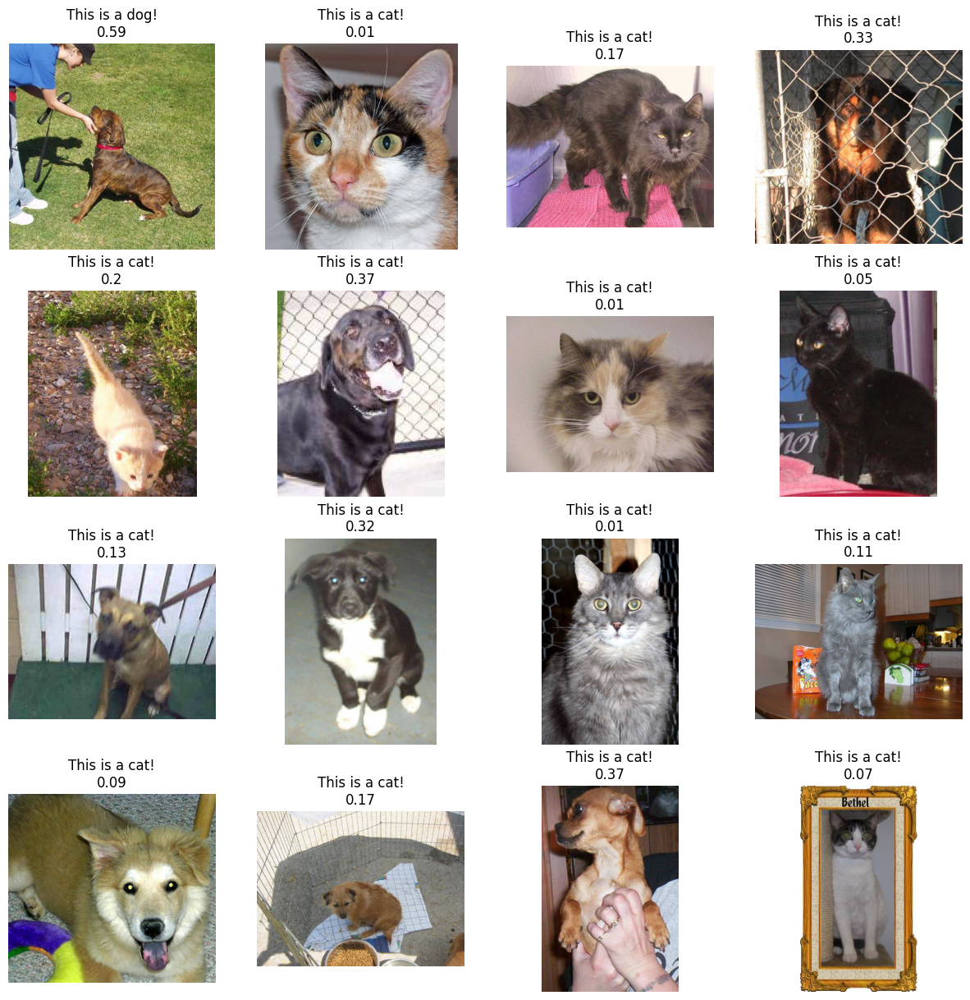

In [12]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [14]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/weight_1.pth")

Are we satisfied ? We can see that the validation loss had a very up and down trend during training. On the other hand, the training loss had a much linear trend during training, suggesting that we are encountering some kind of overfitting.

This is usually not a good sign, so in the next section we will cover some strategies on how to counteract this phenomenon, called overfitting.

Note that dropout is already one method to counteract overfitting, but we will see more in the next section.

# PROVIDING MORE DIFFERENTIATED TRAINING EXAMPLES TO THE NETWORK

When dealing with data, the best way to reduce overfitting is always provide more data to the network. But how can we do if we don't have more data? One way can be to augment the data that we already have, to synthetically increase the size of the dataset. This is a very powerful technique, but depending on the task cna be more or less difficult to do. 
For example, when dealing with object detection, we must transform both the input data and the labels accordingly. When dealing with text, more particular types of augmentation are used, such as word dropout, word swap, etc.

In the simple case of classification, we want instead that the network is able to recognize what is the category of the image, so the label in this case does not have a structure.
In this case we can augment the dataset by applying different transformations to the input and leaving the label as it is. Let's try!

We will experiment with the following transformations:
- Random rotation
- Random horizontal flip
- Random vertical flip
- Random crop

# INCREASING THE VARIABILITY ON THE TRAINING SET 
In this case, the approach is different, we will reduce overfitting by introducing the so called augmentations on the training set. Augmentations refers to artificially created configuration on the input data, that indeed does not affect the label. In the case of classification, we can assume that both an image and its flipped version are images of the same label (eg cat). A lot of different forms of image augmentations have been conceived, and pytorch make it very straightforward to apply those transformations directly when data are passed to the dataloader. 
On this link, several different transformation can be found, which can be applied in different contexts (https://pytorch.org/vision/stable/transforms.html)

In [4]:
import torchvision.transforms as transf

transforms_train = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
                            transf.RandomHorizontalFlip(0.5),
                            transf.RandomApply([transf.RandomRotation((0,360))],p=0.5),
                            transf.RandomVerticalFlip(0.5),
                            transf.RandomApply([transf.RandomResizedCrop((256,256), scale=(0.7,1.0))], p=0.5)
                            ])
transforms_test_val = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])

In [16]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

_init_seed(0)

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

##############################################################################

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = SimpleNet()
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))

# Hyperparameters 
learning_rate = 5e-3
epochs = 20 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

Tot model parameters: 567297
Epoch: 0


100%|██████████| 79/79 [00:20<00:00,  3.84it/s]



Training loss epoch  0 : 0.6588797861794856
Training accuracy epoch  0 : 0.6060014204545454
Validation loss epoch  0 : 1.0274153887471067
Validation accuracy epoch  0 : 0.4936708860759494
Epoch: 1


100%|██████████| 79/79 [00:14<00:00,  5.44it/s]



Training loss epoch  1 : 0.6308953533457085
Training accuracy epoch  1 : 0.6370738636363636
Validation loss epoch  1 : 0.7423413878754724
Validation accuracy epoch  1 : 0.5751582278481012
Epoch: 2


100%|██████████| 79/79 [00:18<00:00,  4.21it/s]



Training loss epoch  2 : 0.6047601598653604
Training accuracy epoch  2 : 0.6695667613636364
Validation loss epoch  2 : 0.9134396473063698
Validation accuracy epoch  2 : 0.5181962025316456
Epoch: 3


100%|██████████| 79/79 [00:19<00:00,  4.00it/s]



Training loss epoch  3 : 0.5952383204871281
Training accuracy epoch  3 : 0.6690340909090909
Validation loss epoch  3 : 0.8693643966807595
Validation accuracy epoch  3 : 0.5079113924050633
Epoch: 4


100%|██████████| 79/79 [00:16<00:00,  4.84it/s]



Training loss epoch  4 : 0.5866065311922946
Training accuracy epoch  4 : 0.6867897727272727
Validation loss epoch  4 : 1.2411300351348105
Validation accuracy epoch  4 : 0.4699367088607595
Epoch: 5


100%|██████████| 79/79 [00:25<00:00,  3.13it/s]



Training loss epoch  5 : 0.6152347992174327
Training accuracy epoch  5 : 0.6545632102272727
Validation loss epoch  5 : 0.810993459783023
Validation accuracy epoch  5 : 0.507120253164557
Epoch: 6


100%|██████████| 79/79 [00:20<00:00,  3.89it/s]



Training loss epoch  6 : 0.5853272446177222
Training accuracy epoch  6 : 0.6857244318181818
Validation loss epoch  6 : 0.9776436663881133
Validation accuracy epoch  6 : 0.4802215189873418
Epoch: 7


100%|██████████| 79/79 [00:17<00:00,  4.56it/s]



Training loss epoch  7 : 0.5815214712850072
Training accuracy epoch  7 : 0.6868785511363636
Validation loss epoch  7 : 0.9713496015041689
Validation accuracy epoch  7 : 0.4944620253164557
Epoch: 8


100%|██████████| 79/79 [00:25<00:00,  3.16it/s]



Training loss epoch  8 : 0.5762576573867012
Training accuracy epoch  8 : 0.6975319602272727
Validation loss epoch  8 : 0.9350744346274605
Validation accuracy epoch  8 : 0.5237341772151899
Epoch: 9


100%|██████████| 79/79 [00:19<00:00,  4.00it/s]



Training loss epoch  9 : 0.5706392364068464
Training accuracy epoch  9 : 0.6977982954545454
Validation loss epoch  9 : 0.7080760428422614
Validation accuracy epoch  9 : 0.5830696202531646
Epoch: 10


100%|██████████| 79/79 [00:18<00:00,  4.18it/s]



Training loss epoch  10 : 0.5718222438696433
Training accuracy epoch  10 : 0.6977095170454546
Validation loss epoch  10 : 0.9724205438094803
Validation accuracy epoch  10 : 0.49287974683544306
Epoch: 11


100%|██████████| 79/79 [00:23<00:00,  3.35it/s]



Training loss epoch  11 : 0.565797043625604
Training accuracy epoch  11 : 0.6998401988636364
Validation loss epoch  11 : 0.9776064662993709
Validation accuracy epoch  11 : 0.497626582278481
Epoch: 12


100%|██████████| 79/79 [00:18<00:00,  4.37it/s]



Training loss epoch  12 : 0.5660151064141907
Training accuracy epoch  12 : 0.7032137784090909
Validation loss epoch  12 : 0.9523267134835448
Validation accuracy epoch  12 : 0.5
Epoch: 13


100%|██████████| 79/79 [00:18<00:00,  4.26it/s]



Training loss epoch  13 : 0.559483561580154
Training accuracy epoch  13 : 0.7074751420454546
Validation loss epoch  13 : 1.0130613431145874
Validation accuracy epoch  13 : 0.49050632911392406
Epoch: 14


100%|██████████| 79/79 [00:23<00:00,  3.31it/s]



Training loss epoch  14 : 0.5607591845857148
Training accuracy epoch  14 : 0.7025035511363636
Validation loss epoch  14 : 0.9426085458526129
Validation accuracy epoch  14 : 0.5039556962025317
Epoch: 15


100%|██████████| 79/79 [00:17<00:00,  4.62it/s]



Training loss epoch  15 : 0.5612138687548313
Training accuracy epoch  15 : 0.7022372159090909
Validation loss epoch  15 : 0.9637877156462851
Validation accuracy epoch  15 : 0.5063291139240507
Epoch: 16


100%|██████████| 79/79 [00:19<00:00,  4.08it/s]



Training loss epoch  16 : 0.5562274229543452
Training accuracy epoch  16 : 0.7072975852272727
Validation loss epoch  16 : 0.9496302295334732
Validation accuracy epoch  16 : 0.49920886075949367
Epoch: 17


100%|██████████| 79/79 [00:24<00:00,  3.25it/s]



Training loss epoch  17 : 0.5511535497128286
Training accuracy epoch  17 : 0.7144886363636364
Validation loss epoch  17 : 0.8767117986196205
Validation accuracy epoch  17 : 0.5229430379746836
Epoch: 18


100%|██████████| 79/79 [00:18<00:00,  4.23it/s]



Training loss epoch  18 : 0.5515076822431927
Training accuracy epoch  18 : 0.7142223011363636
Validation loss epoch  18 : 0.9970133961001529
Validation accuracy epoch  18 : 0.5079113924050633
Epoch: 19


100%|██████████| 79/79 [00:18<00:00,  4.25it/s]


Training loss epoch  19 : 0.5464409515684978
Training accuracy epoch  19 : 0.7165305397727273
Validation loss epoch  19 : 0.9002928232090383
Validation accuracy epoch  19 : 0.5237341772151899


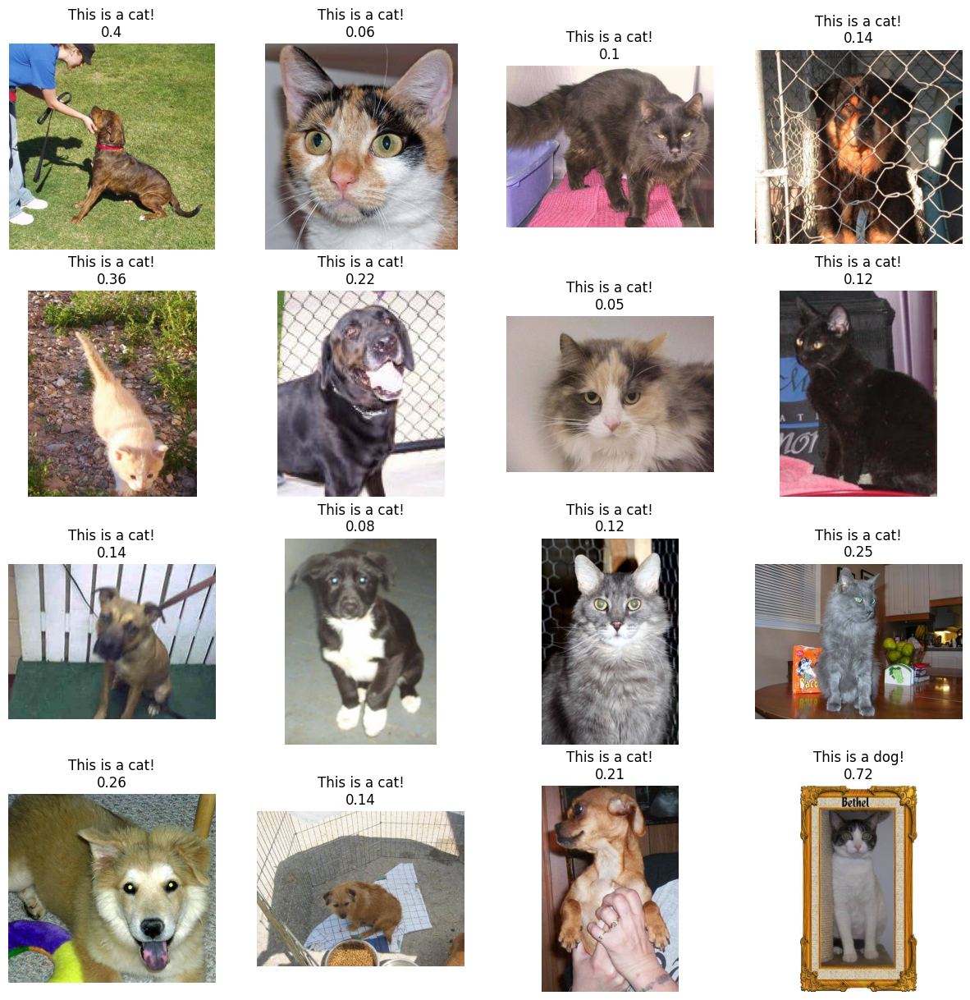

In [17]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [18]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/weight_2.pth")

# What can we do more? 

In general, building a network from scratch when dealing with such simple problems is not a good idea.
We can try to leverage the module torchvision.models and borrow an architecture that has been developed by experts and has been tested on several benchmarks.
For example, let's try to see how straightforward it is to use a network, such as ResNet18, and see how it performs on our dataset.

In [5]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

from torchvision.models import mobilenet_v3_small

_init_seed(0)

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = mobilenet_v3_small() #############################################################
# Replace the last layer of the model with a new one
model.classifier = torch.nn.Sequential(*list(model.classifier.children())[:-1],torch.nn.Linear(1024,1), torch.nn.Sigmoid()) #########################
# We are ready to train, no other modifications needed
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))

# Hyperparameters 
learning_rate = 5e-3
epochs = 20 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

Tot model parameters: 1518881
Epoch: 0


100%|██████████| 79/79 [00:17<00:00,  4.50it/s]



Training loss epoch  0 : 0.6864677298475396
Training accuracy epoch  0 : 0.5594815340909091
Validation loss epoch  0 : 0.6945034891744203
Validation accuracy epoch  0 : 0.4944620253164557
Epoch: 1


100%|██████████| 79/79 [00:22<00:00,  3.52it/s]



Training loss epoch  1 : 0.6764237499711189
Training accuracy epoch  1 : 0.5790127840909091
Validation loss epoch  1 : 0.6624587200864961
Validation accuracy epoch  1 : 0.5988924050632911
Epoch: 2


100%|██████████| 79/79 [00:21<00:00,  3.71it/s]



Training loss epoch  2 : 0.6474683307619258
Training accuracy epoch  2 : 0.6249112215909091
Validation loss epoch  2 : 0.6816365865966941
Validation accuracy epoch  2 : 0.5909810126582279
Epoch: 3


100%|██████████| 79/79 [00:15<00:00,  5.05it/s]



Training loss epoch  3 : 0.621409981045872
Training accuracy epoch  3 : 0.6557173295454546
Validation loss epoch  3 : 0.6530719218374808
Validation accuracy epoch  3 : 0.6265822784810127
Epoch: 4


100%|██████████| 79/79 [00:21<00:00,  3.65it/s]



Training loss epoch  4 : 0.6006804236888208
Training accuracy epoch  4 : 0.6774680397727273
Validation loss epoch  4 : 0.5877267473106143
Validation accuracy epoch  4 : 0.685126582278481
Epoch: 5


100%|██████████| 79/79 [00:25<00:00,  3.09it/s]



Training loss epoch  5 : 0.583480111323297
Training accuracy epoch  5 : 0.6900745738636364
Validation loss epoch  5 : 0.5615181953092164
Validation accuracy epoch  5 : 0.7080696202531646
Epoch: 6


100%|██████████| 79/79 [00:19<00:00,  4.03it/s]



Training loss epoch  6 : 0.5727746534076604
Training accuracy epoch  6 : 0.7001953125
Validation loss epoch  6 : 0.5662738865689386
Validation accuracy epoch  6 : 0.7088607594936709
Epoch: 7


100%|██████████| 79/79 [00:19<00:00,  4.15it/s]



Training loss epoch  7 : 0.5587069512006234
Training accuracy epoch  7 : 0.7105823863636364
Validation loss epoch  7 : 0.5540977241117743
Validation accuracy epoch  7 : 0.7112341772151899
Epoch: 8


100%|██████████| 79/79 [00:23<00:00,  3.34it/s]



Training loss epoch  8 : 0.5507184120360762
Training accuracy epoch  8 : 0.7199041193181818
Validation loss epoch  8 : 0.5076476014867614
Validation accuracy epoch  8 : 0.754746835443038
Epoch: 9


100%|██████████| 79/79 [00:21<00:00,  3.70it/s]



Training loss epoch  9 : 0.5418176793239333
Training accuracy epoch  9 : 0.7254971590909091
Validation loss epoch  9 : 0.5557628349412845
Validation accuracy epoch  9 : 0.6914556962025317
Epoch: 10


100%|██████████| 79/79 [00:15<00:00,  5.04it/s]



Training loss epoch  10 : 0.5360535785809837
Training accuracy epoch  10 : 0.728515625
Validation loss epoch  10 : 0.506358049338377
Validation accuracy epoch  10 : 0.7468354430379747
Epoch: 11


100%|██████████| 79/79 [00:22<00:00,  3.52it/s]



Training loss epoch  11 : 0.5213617018254643
Training accuracy epoch  11 : 0.7414772727272727
Validation loss epoch  11 : 0.5049605763788465
Validation accuracy epoch  11 : 0.7618670886075949
Epoch: 12


100%|██████████| 79/79 [00:23<00:00,  3.36it/s]



Training loss epoch  12 : 0.5078731000804427
Training accuracy epoch  12 : 0.7499112215909091
Validation loss epoch  12 : 0.4864182145912436
Validation accuracy epoch  12 : 0.7587025316455697
Epoch: 13


100%|██████████| 79/79 [00:16<00:00,  4.72it/s]



Training loss epoch  13 : 0.5140797327357259
Training accuracy epoch  13 : 0.7464488636363636
Validation loss epoch  13 : 0.5069333214925814
Validation accuracy epoch  13 : 0.7436708860759493
Epoch: 14


100%|██████████| 79/79 [00:22<00:00,  3.59it/s]



Training loss epoch  14 : 0.5025064552583817
Training accuracy epoch  14 : 0.7527521306818182
Validation loss epoch  14 : 0.48413460635686223
Validation accuracy epoch  14 : 0.7721518987341772
Epoch: 15


100%|██████████| 79/79 [00:26<00:00,  3.03it/s]



Training loss epoch  15 : 0.4995642971797762
Training accuracy epoch  15 : 0.7569247159090909
Validation loss epoch  15 : 0.49438693157479735
Validation accuracy epoch  15 : 0.7507911392405063
Epoch: 16


100%|██████████| 79/79 [00:20<00:00,  3.81it/s]



Training loss epoch  16 : 0.49262742761691863
Training accuracy epoch  16 : 0.7579900568181818
Validation loss epoch  16 : 0.49833358050901677
Validation accuracy epoch  16 : 0.7555379746835443
Epoch: 17


100%|██████████| 79/79 [00:19<00:00,  4.01it/s]



Training loss epoch  17 : 0.485046511515975
Training accuracy epoch  17 : 0.7649147727272727
Validation loss epoch  17 : 0.4738867297957215
Validation accuracy epoch  17 : 0.7531645569620253
Epoch: 18


100%|██████████| 79/79 [00:22<00:00,  3.55it/s]



Training loss epoch  18 : 0.4802686101968654
Training accuracy epoch  18 : 0.7705965909090909
Validation loss epoch  18 : 0.7323079659968992
Validation accuracy epoch  18 : 0.6471518987341772
Epoch: 19


100%|██████████| 79/79 [00:18<00:00,  4.29it/s]


Training loss epoch  19 : 0.47501852589828725
Training accuracy epoch  19 : 0.7713955965909091
Validation loss epoch  19 : 0.5561150155867203
Validation accuracy epoch  19 : 0.7310126582278481


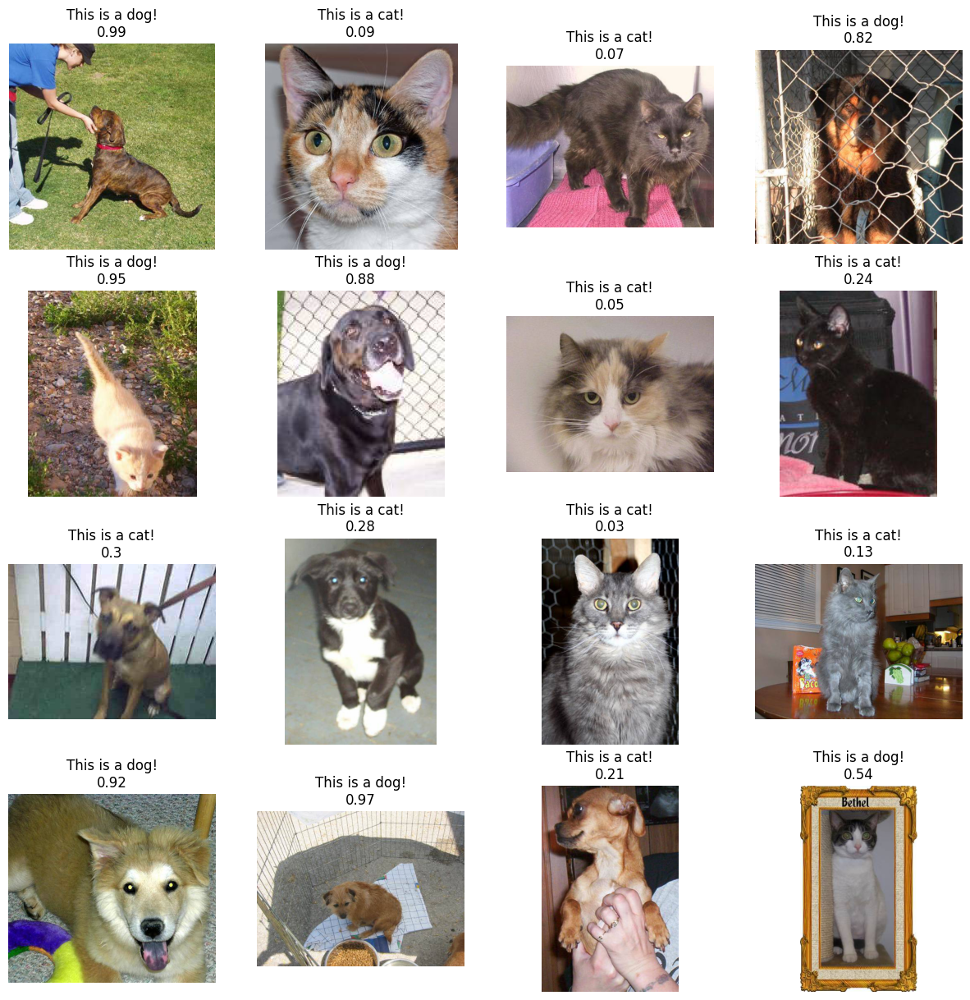

In [6]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

Already much better!

It turns out that we can do even more! 

Transfer learning is a technique that leverages a pretrained network, and just adapts part of it to the specific task.

For example, we can use a pretrained network and fine tune just the last classification layer to our specific needs! This means that we can just tune the last 512x1 parameters!! All the others we keep them fixed, since the pretraining step already teached the network how to recognize the most common features in images.

To add more to this, since in training we just require the computing of the gradients of the last weights, training will be much faster, and we can load bigger networks!

For now, let's try with the same architecture, but with pre-trained weights!

Let's see how straightforward it is to do this in pytorch!

In [5]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

from torchvision.models import mobilenet_v3_small, MobileNet_V3_Small_Weights

_init_seed(0)

# Use the same transformations used by mobileNetv3small during training
transforms_train = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
transforms_test_val = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = mobilenet_v3_small(weights=MobileNet_V3_Small_Weights.DEFAULT) #############################################################
# Replace the last layer of the model with a new one
model.classifier = torch.nn.Sequential(*list(model.classifier.children())[:-1],torch.nn.Linear(1024,1), torch.nn.Sigmoid()) #########################
# Freeze the parameters of the model, except for the last layer
for name, param in model.named_parameters():
  if(name!="classifier.3.weight" and name!="classifier.3.bias"):
    param.requires_grad = False
  
for name, param in model.named_parameters():
  print(name, param.requires_grad)
    
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))
print("Tot trainable parameters:", sum([param.numel() for param in model.parameters() if param.requires_grad]))

# Hyperparameters 
learning_rate = 5e-3
epochs = 5 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

features.0.0.weight False
features.0.1.weight False
features.0.1.bias False
features.1.block.0.0.weight False
features.1.block.0.1.weight False
features.1.block.0.1.bias False
features.1.block.1.fc1.weight False
features.1.block.1.fc1.bias False
features.1.block.1.fc2.weight False
features.1.block.1.fc2.bias False
features.1.block.2.0.weight False
features.1.block.2.1.weight False
features.1.block.2.1.bias False
features.2.block.0.0.weight False
features.2.block.0.1.weight False
features.2.block.0.1.bias False
features.2.block.1.0.weight False
features.2.block.1.1.weight False
features.2.block.1.1.bias False
features.2.block.2.0.weight False
features.2.block.2.1.weight False
features.2.block.2.1.bias False
features.3.block.0.0.weight False
features.3.block.0.1.weight False
features.3.block.0.1.bias False
features.3.block.1.0.weight False
features.3.block.1.1.weight False
features.3.block.1.1.bias False
features.3.block.2.0.weight False
features.3.block.2.1.weight False
features.3.block

100%|██████████| 79/79 [00:19<00:00,  4.12it/s]



Training loss epoch  0 : 0.29383591534993186
Training accuracy epoch  0 : 0.9067826704545454
Validation loss epoch  0 : 0.1806355820426458
Validation accuracy epoch  0 : 0.939873417721519
Epoch: 1


100%|██████████| 79/79 [00:17<00:00,  4.46it/s]



Training loss epoch  1 : 0.20347638644637878
Training accuracy epoch  1 : 0.9265802556818182
Validation loss epoch  1 : 0.1591915392517289
Validation accuracy epoch  1 : 0.9375
Epoch: 2


100%|██████████| 79/79 [00:17<00:00,  4.45it/s]



Training loss epoch  2 : 0.1847942398400681
Training accuracy epoch  2 : 0.9305752840909091
Validation loss epoch  2 : 0.14615291588102716
Validation accuracy epoch  2 : 0.942246835443038
Epoch: 3


100%|██████████| 79/79 [00:15<00:00,  5.26it/s]



Training loss epoch  3 : 0.1728829226128503
Training accuracy epoch  3 : 0.9344815340909091
Validation loss epoch  3 : 0.13981193348859686
Validation accuracy epoch  3 : 0.9438291139240507
Epoch: 4


100%|██████████| 79/79 [00:12<00:00,  6.12it/s]


Training loss epoch  4 : 0.17305667570855637
Training accuracy epoch  4 : 0.9317294034090909
Validation loss epoch  4 : 0.13873844888485684
Validation accuracy epoch  4 : 0.9430379746835443


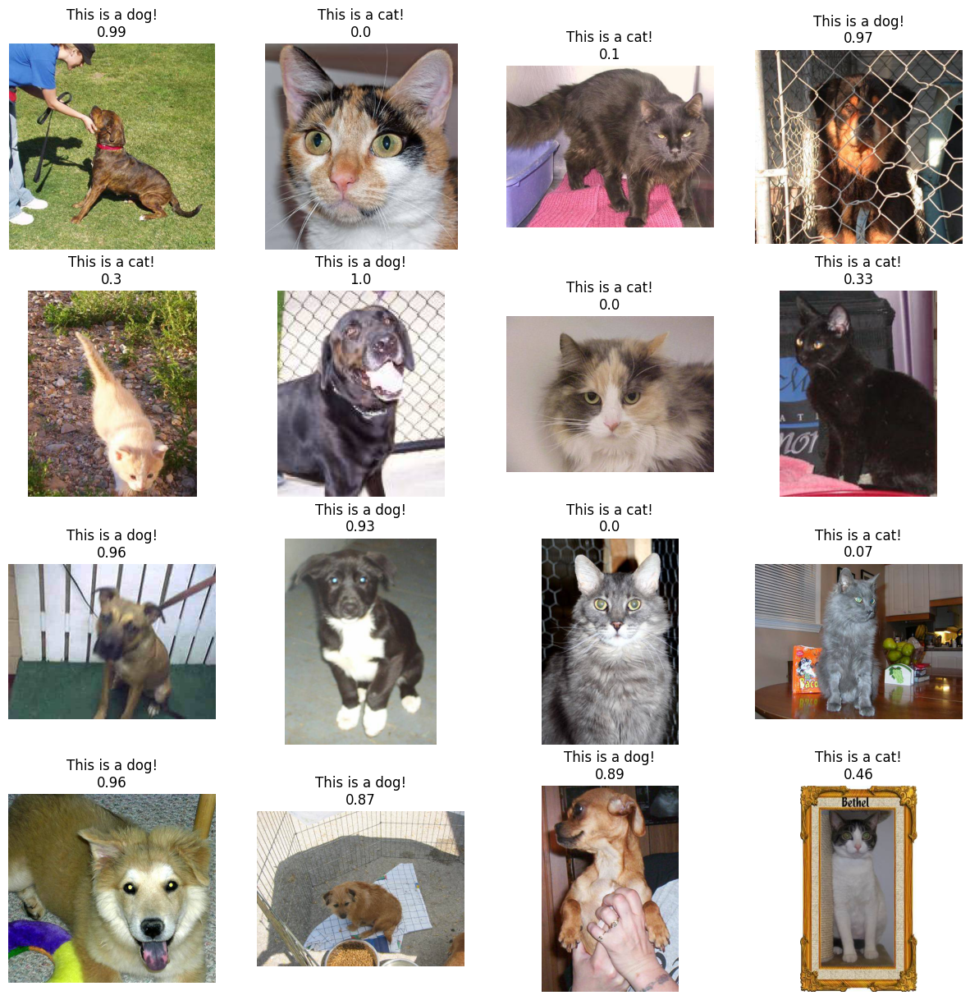

In [8]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [7]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/mobileNetv3_only_last_layer.pth")

Usually after training for some epochs with only the last layer unfreezed, the last step is to load the network again, unfreeze all the parameters, decrease the learning rate, and proceed to train all the network for some other epochs. This usually futrher increase slighly the performance of the network, let's try it!

In [9]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

from torchvision.models import mobilenet_v3_small

_init_seed(0)

# Use the same transformations used by mobileNetv3small during training
transforms_train = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
transforms_test_val = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = mobilenet_v3_small() #############################################################
# Replace the last layer of the model with a new one
model.classifier = torch.nn.Sequential(*list(model.classifier.children())[:-1],torch.nn.Linear(1024,1), torch.nn.Sigmoid()) #########################
# Freeze the parameters of the model, except for the last layer
model.load_state_dict(torch.load("weights/mobileNetv3_only_last_layer.pth"))
  
for name, param in model.named_parameters():
  print(name, param.requires_grad)
    
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))
print("Tot trainable parameters:", sum([param.numel() for param in model.parameters() if param.requires_grad]))

# Hyperparameters 
learning_rate = 1e-4 # Decrease the learning rate !
epochs = 5 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

features.0.0.weight True
features.0.1.weight True
features.0.1.bias True
features.1.block.0.0.weight True
features.1.block.0.1.weight True
features.1.block.0.1.bias True
features.1.block.1.fc1.weight True
features.1.block.1.fc1.bias True
features.1.block.1.fc2.weight True
features.1.block.1.fc2.bias True
features.1.block.2.0.weight True
features.1.block.2.1.weight True
features.1.block.2.1.bias True
features.2.block.0.0.weight True
features.2.block.0.1.weight True
features.2.block.0.1.bias True
features.2.block.1.0.weight True
features.2.block.1.1.weight True
features.2.block.1.1.bias True
features.2.block.2.0.weight True
features.2.block.2.1.weight True
features.2.block.2.1.bias True
features.3.block.0.0.weight True
features.3.block.0.1.weight True
features.3.block.0.1.bias True
features.3.block.1.0.weight True
features.3.block.1.1.weight True
features.3.block.1.1.bias True
features.3.block.2.0.weight True
features.3.block.2.1.weight True
features.3.block.2.1.bias True
features.4.bloc

100%|██████████| 79/79 [00:15<00:00,  5.03it/s]



Training loss epoch  0 : 0.16599844844313338
Training accuracy epoch  0 : 0.9333274147727273
Validation loss epoch  0 : 0.13569172574325075
Validation accuracy epoch  0 : 0.9477848101265823
Epoch: 1


100%|██████████| 79/79 [00:19<00:00,  4.02it/s]



Training loss epoch  1 : 0.16376300004247407
Training accuracy epoch  1 : 0.9356356534090909
Validation loss epoch  1 : 0.13703600874264973
Validation accuracy epoch  1 : 0.9438291139240507
Epoch: 2


100%|██████████| 79/79 [00:15<00:00,  5.05it/s]



Training loss epoch  2 : 0.16088327574834693
Training accuracy epoch  2 : 0.9382990056818182
Validation loss epoch  2 : 0.13326549324902554
Validation accuracy epoch  2 : 0.9462025316455697
Epoch: 3


100%|██████████| 79/79 [00:12<00:00,  6.36it/s]



Training loss epoch  3 : 0.15660756137962875
Training accuracy epoch  3 : 0.9422052556818182
Validation loss epoch  3 : 0.13105768849483773
Validation accuracy epoch  3 : 0.9501582278481012
Epoch: 4


100%|██████████| 79/79 [00:16<00:00,  4.66it/s]


Training loss epoch  4 : 0.16061182656664064
Training accuracy epoch  4 : 0.9366122159090909
Validation loss epoch  4 : 0.1318629056014875
Validation accuracy epoch  4 : 0.9477848101265823


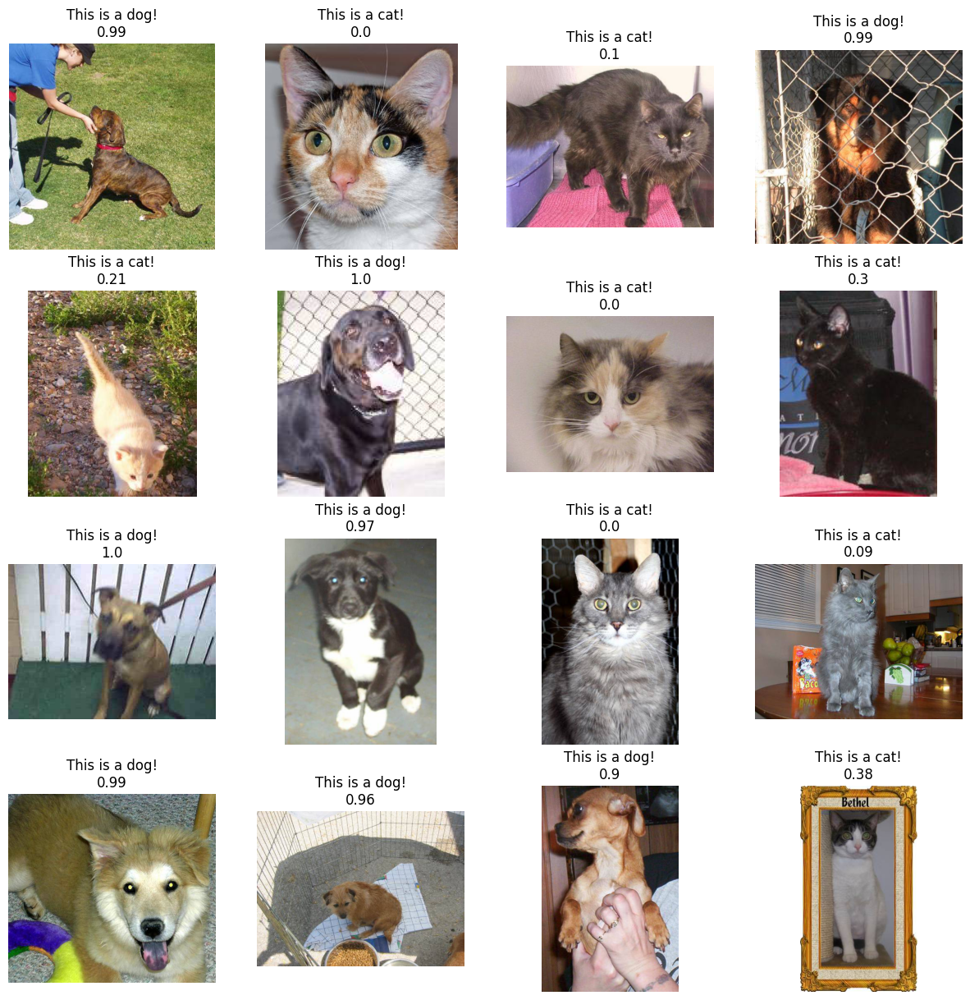

In [10]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [11]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/mobileNetv3_after_finetuning.pth")

Now, just for fun, let's try with a Resnet18 (11 millions of parameters)

In [13]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

from torchvision.models import resnet18, ResNet18_Weights

_init_seed(0)

# Use the same transformations used by resnet18 during training
transforms_train = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
transforms_test_val = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = resnet18(weights=ResNet18_Weights.DEFAULT) #############################################################
# Replace the last layer of the model with a new one
model.fc = torch.nn.Sequential(torch.nn.Linear(512,1), torch.nn.Sigmoid()) #########################
# Freeze the parameters of the model, except for the last layer
for name, param in model.named_parameters():
  if(name!="fc.0.weight" and name!="fc.0.bias"):
    param.requires_grad = False
  
for name, param in model.named_parameters():
  print(name, param.requires_grad)
    
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))
print("Tot trainable parameters:", sum([param.numel() for param in model.parameters() if param.requires_grad]))

# Hyperparameters 
learning_rate = 5e-3
epochs = 5 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

conv1.weight False
bn1.weight False
bn1.bias False
layer1.0.conv1.weight False
layer1.0.bn1.weight False
layer1.0.bn1.bias False
layer1.0.conv2.weight False
layer1.0.bn2.weight False
layer1.0.bn2.bias False
layer1.1.conv1.weight False
layer1.1.bn1.weight False
layer1.1.bn1.bias False
layer1.1.conv2.weight False
layer1.1.bn2.weight False
layer1.1.bn2.bias False
layer2.0.conv1.weight False
layer2.0.bn1.weight False
layer2.0.bn1.bias False
layer2.0.conv2.weight False
layer2.0.bn2.weight False
layer2.0.bn2.bias False
layer2.0.downsample.0.weight False
layer2.0.downsample.1.weight False
layer2.0.downsample.1.bias False
layer2.1.conv1.weight False
layer2.1.bn1.weight False
layer2.1.bn1.bias False
layer2.1.conv2.weight False
layer2.1.bn2.weight False
layer2.1.bn2.bias False
layer3.0.conv1.weight False
layer3.0.bn1.weight False
layer3.0.bn1.bias False
layer3.0.conv2.weight False
layer3.0.bn2.weight False
layer3.0.bn2.bias False
layer3.0.downsample.0.weight False
layer3.0.downsample.1.weight Fa

100%|██████████| 79/79 [00:21<00:00,  3.67it/s]



Training loss epoch  0 : 0.18106383269001858
Training accuracy epoch  0 : 0.9382990056818182
Validation loss epoch  0 : 0.09386143503015083
Validation accuracy epoch  0 : 0.9667721518987342
Epoch: 1


100%|██████████| 79/79 [00:19<00:00,  4.01it/s]



Training loss epoch  1 : 0.115273840521199
Training accuracy epoch  1 : 0.9558771306818182
Validation loss epoch  1 : 0.08103330504691487
Validation accuracy epoch  1 : 0.9707278481012658
Epoch: 2


100%|██████████| 79/79 [00:19<00:00,  4.13it/s]



Training loss epoch  2 : 0.10606686571687036
Training accuracy epoch  2 : 0.9612038352272727
Validation loss epoch  2 : 0.07299568408899763
Validation accuracy epoch  2 : 0.9723101265822784
Epoch: 3


100%|██████████| 79/79 [00:20<00:00,  3.83it/s]



Training loss epoch  3 : 0.10182678450490296
Training accuracy epoch  3 : 0.9612038352272727
Validation loss epoch  3 : 0.07523680323752563
Validation accuracy epoch  3 : 0.9707278481012658
Epoch: 4


100%|██████████| 79/79 [00:19<00:00,  4.06it/s]


Training loss epoch  4 : 0.10080015090947696
Training accuracy epoch  4 : 0.9600497159090909
Validation loss epoch  4 : 0.07326897979740501
Validation accuracy epoch  4 : 0.9707278481012658


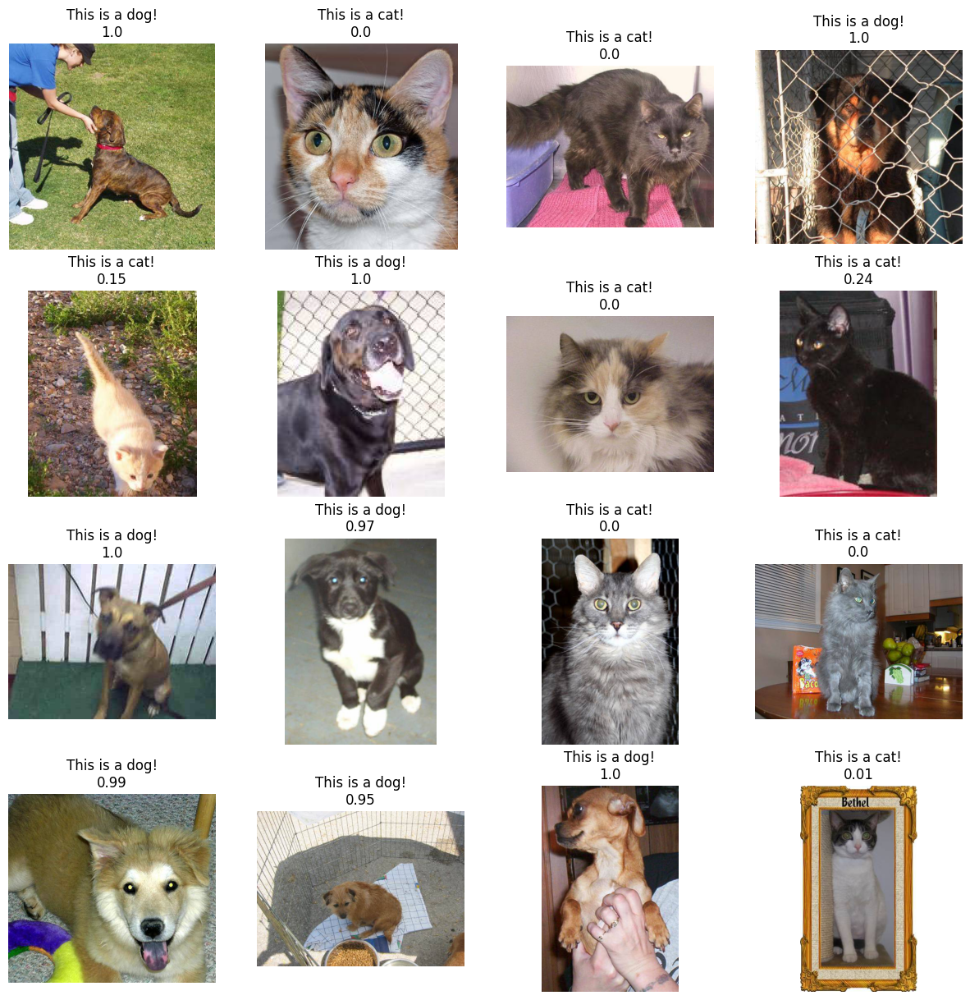

In [14]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [15]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/resnet18_only_last_layer.pth")

In [17]:
from workers import get_datasets, get_loaders
from torch.optim import SGD
from torch.nn import BCELoss
from tqdm import tqdm

from torchvision.models import resnet18, ResNet18_Weights

_init_seed(0)

# Use the same transformations used by resnet18 during training
transforms_train = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
transforms_test_val = transf.Compose([
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])

trainset, valset, testset = get_datasets("train", "test", 0.1, 0.5, transforms_train, transforms_test_val)
trainloader, valloader, testloader = get_loaders(trainset, valset, testset, 16, 8, True)

# Use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Get the model 
model = resnet18() #############################################################
# Replace the last layer of the model with a new one
model.fc = torch.nn.Sequential(torch.nn.Linear(512,1), torch.nn.Sigmoid()) #########################
model.load_state_dict(torch.load("weights/resnet18_only_last_layer.pth"))
  
for name, param in model.named_parameters():
  print(name, param.requires_grad)
    
model.to(device)

print("Tot model parameters:", sum([param.numel() for param in model.parameters()]))
print("Tot trainable parameters:", sum([param.numel() for param in model.parameters() if param.requires_grad]))

# Hyperparameters 
learning_rate = 1e-4 # Decrease learning rate
epochs = 5 

# Get the optimizer
optimizer = SGD(model.parameters(),lr=learning_rate)

# Get the loss function 
loss_fn = BCELoss(reduction="mean")

# Start the training loop
for epoch in range(epochs):
  loss_training = 0
  accuracy_training = 0 
  print("Epoch:", epoch)
  for i, data in enumerate(tqdm(trainloader)):
    imgs, labels = data
    # Send data to GPU
    imgs = imgs.to(device)
    labels = labels.to(device)
    predictions = model(imgs)
    loss = loss_fn(predictions.squeeze(),labels.view(-1))
    # Calculate the training accuracy 
    accuracy_training += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()

    # Zero the gradients in the optimizer
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_training += loss.item()
  
  # Test on validation images 
  loss_validation = 0
  accuracy_validation = 0
  with torch.no_grad():
    model.eval()
    for i, data in enumerate(tqdm(valloader)):
      imgs, labels = data
      # Send data to GPU
      imgs = imgs.to(device)
      labels = labels.to(device)
      predictions = model(imgs)
      loss = loss_fn(predictions.squeeze(),labels.view(-1))
      loss_validation += loss.item()
      accuracy_validation += (sum(torch.round(predictions.squeeze())==labels.view(-1))/imgs.shape[0]).item()
      
    # Put again model in training mode
    model.train()

  print("\nTraining loss epoch ",epoch,":",loss_training/len(trainloader))
  print("Training accuracy epoch ",epoch,":",accuracy_training/len(trainloader))
  print("Validation loss epoch ",epoch,":",loss_validation/len(valloader))
  print("Validation accuracy epoch ",epoch,":",accuracy_validation/len(valloader))

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x000001A104BD0D30>
Traceback (most recent call last):
  File "c:\Users\Melgani\anaconda3\envs\newnlpt\lib\site-packages\torch\utils\data\dataloader.py", line 1466, in __del__
    self._shutdown_workers()
  File "c:\Users\Melgani\anaconda3\envs\newnlpt\lib\site-packages\torch\utils\data\dataloader.py", line 1425, in _shutdown_workers
    self._mark_worker_as_unavailable(worker_id, shutdown=True)
  File "c:\Users\Melgani\anaconda3\envs\newnlpt\lib\site-packages\torch\utils\data\dataloader.py", line 1367, in _mark_worker_as_unavailable
    assert self._workers_status[worker_id] or (self._persistent_workers and shutdown)
AttributeError: '_MultiProcessingDataLoaderIter' object has no attribute '_workers_status'


conv1.weight True
bn1.weight True
bn1.bias True
layer1.0.conv1.weight True
layer1.0.bn1.weight True
layer1.0.bn1.bias True
layer1.0.conv2.weight True
layer1.0.bn2.weight True
layer1.0.bn2.bias True
layer1.1.conv1.weight True
layer1.1.bn1.weight True
layer1.1.bn1.bias True
layer1.1.conv2.weight True
layer1.1.bn2.weight True
layer1.1.bn2.bias True
layer2.0.conv1.weight True
layer2.0.bn1.weight True
layer2.0.bn1.bias True
layer2.0.conv2.weight True
layer2.0.bn2.weight True
layer2.0.bn2.bias True
layer2.0.downsample.0.weight True
layer2.0.downsample.1.weight True
layer2.0.downsample.1.bias True
layer2.1.conv1.weight True
layer2.1.bn1.weight True
layer2.1.bn1.bias True
layer2.1.conv2.weight True
layer2.1.bn2.weight True
layer2.1.bn2.bias True
layer3.0.conv1.weight True
layer3.0.bn1.weight True
layer3.0.bn1.bias True
layer3.0.conv2.weight True
layer3.0.bn2.weight True
layer3.0.bn2.bias True
layer3.0.downsample.0.weight True
layer3.0.downsample.1.weight True
layer3.0.downsample.1.bias True
la

100%|██████████| 79/79 [00:19<00:00,  4.01it/s]



Training loss epoch  0 : 0.09561433978392002
Training accuracy epoch  0 : 0.962890625
Validation loss epoch  0 : 0.07039636763363864
Validation accuracy epoch  0 : 0.9738924050632911
Epoch: 1


100%|██████████| 79/79 [00:18<00:00,  4.37it/s]



Training loss epoch  1 : 0.08742057061396157
Training accuracy epoch  1 : 0.9658203125
Validation loss epoch  1 : 0.06759096796792355
Validation accuracy epoch  1 : 0.9754746835443038
Epoch: 2


100%|██████████| 79/79 [00:18<00:00,  4.19it/s]



Training loss epoch  2 : 0.08562302487751533
Training accuracy epoch  2 : 0.9689275568181818
Validation loss epoch  2 : 0.0650667285066263
Validation accuracy epoch  2 : 0.9786392405063291
Epoch: 3


100%|██████████| 79/79 [00:18<00:00,  4.23it/s]



Training loss epoch  3 : 0.08402170569983851
Training accuracy epoch  3 : 0.9693714488636364
Validation loss epoch  3 : 0.06520090987898491
Validation accuracy epoch  3 : 0.9770569620253164
Epoch: 4


100%|██████████| 79/79 [00:18<00:00,  4.23it/s]


Training loss epoch  4 : 0.08429148835718726
Training accuracy epoch  4 : 0.9667080965909091
Validation loss epoch  4 : 0.0616792157812551
Validation accuracy epoch  4 : 0.9794303797468354


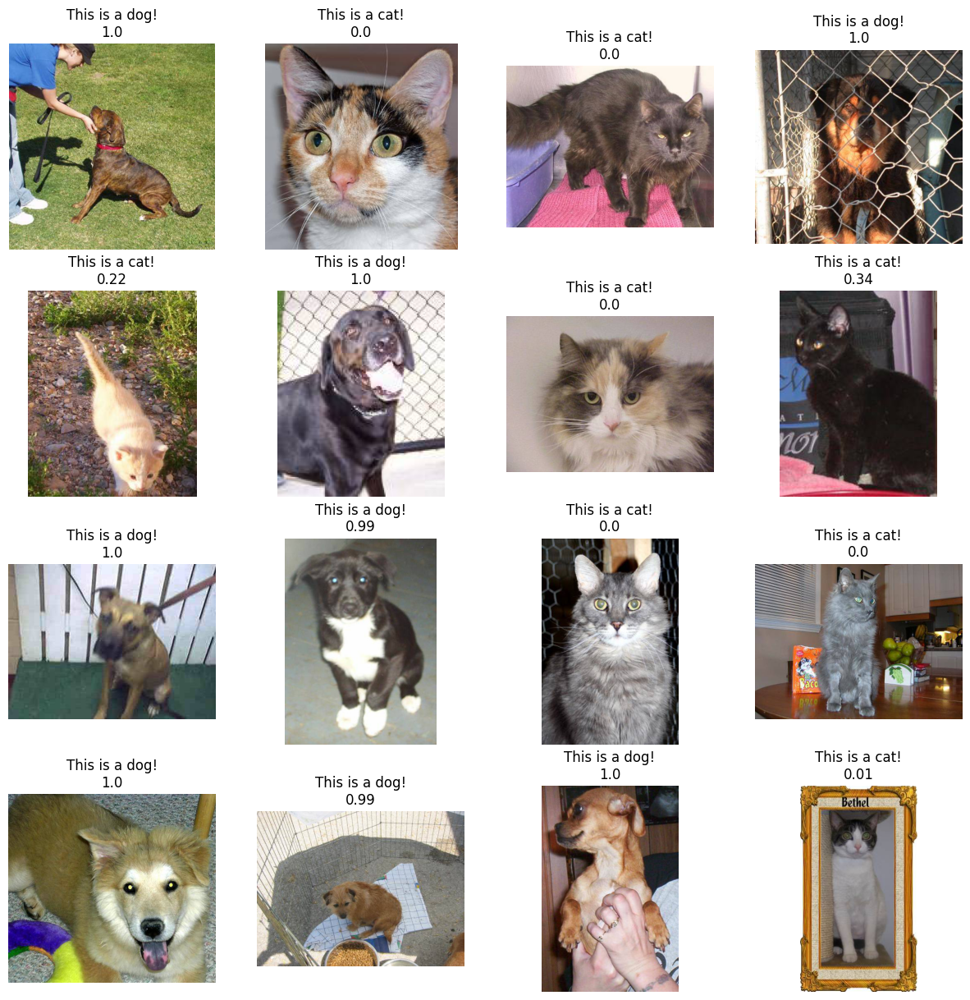

In [18]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,15))
num_images = 16
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!\n"+str(round(out.squeeze().item(),2)))
    else:
      plt.title("This is a cat!\n"+str(round(out.squeeze().item(),2)))

In [19]:
# Save the weights of the network
torch.save(model.state_dict(), "weights/resnet18_after_finetuning.pth")

# LET'S TRY TO PREDICT MORE IMAGES WITH OUR MOST POWERFUL MODEL! 

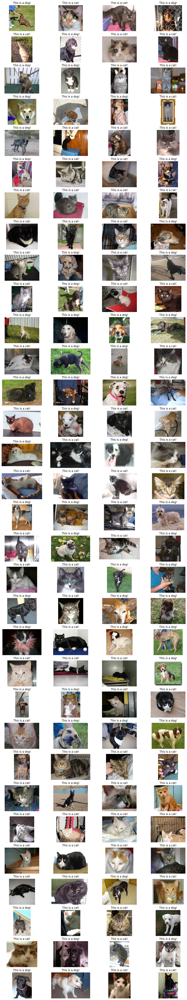

In [22]:
# Explore the data 
files_test = os.listdir("test")
random.seed(0)
random.shuffle(files_test)
fig = plt.figure(figsize=(15,80))
num_images = 128
transforms_test = transf.Compose([
                            transf.ToTensor(),
                            transf.Resize((256,256)), 
                            transf.CenterCrop(224),
                            transf.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                            ])
model.eval()
with torch.no_grad():
  for num, fn in enumerate(files_test[:num_images]):
    path = os.path.join("test",fn)
    img = Image.open(path)
    out = model(transforms_test(img).unsqueeze(0).to(device))
    prediction = out.squeeze()>0.5
    plt.subplot(num_images//4,4,num+1)
    plt.axis('off')
    plt.imshow(img)
    if(prediction):
      plt.title("This is a dog!")
    else:
      plt.title("This is a cat!")

Let's try to submit the solution to kaggle!

In [29]:
# Submission must be in the format of a csv file with two columns: id and label
import csv

files_test = os.listdir("test")

with open('submission2.csv', 'w', newline='') as file:
  writer = csv.writer(file)

  writer.writerow(["id", "label"])
  model.eval()
  with torch.no_grad():
    for num, fn in enumerate(tqdm(files_test)): # ALL IMAGES
      id_img = fn.split(".")[0]
      path = os.path.join("test",fn)
      img = Image.open(path)
      out = model(transforms_test(img).unsqueeze(0).to(device))
      prediction = torch.clamp(out.squeeze(),min=0.02, max=0.98).item()
      writer.writerow([str(id_img),str(prediction)])
    

100%|██████████| 12500/12500 [07:32<00:00, 27.64it/s]


We would have been ended up in 261 th position out of more or less 1350 people!